# Urban Sound Classification EDA & Wrangling Notebook


In [11]:
# import packages

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import json
import os

import librosa as lr
import librosa.display

import wave
from scipy.io import wavfile
import IPython.display

import warnings
warnings.filterwarnings("ignore")


In [2]:
# load csv with sound info

sound_info = pd.read_csv('/Users/spence/Documents/GitHub/Urban Sounds Classifier/UrbanSound8K/metadata/UrbanSound8K.csv')

# Basic EDA

In [3]:
sound_info

,slice_file_name,fsID,start,end,salience,fold,classID,class
0,100032-3-0-0.wav,100032,0.000000,0.317551,1,5,3,dog_bark
1,100263-2-0-117.wav,100263,58.500000,62.500000,1,5,2,children_playing
2,100263-2-0-121.wav,100263,60.500000,64.500000,1,5,2,children_playing
3,100263-2-0-126.wav,100263,63.000000,67.000000,1,5,2,children_playing
4,100263-2-0-137.wav,100263,68.500000,72.500000,1,5,2,children_playing
...,...,...,...,...,...,...,...,...
8727,99812-1-2-0.wav,99812,159.522205,163.522205,2,7,1,car_horn
8728,99812-1-3-0.wav,99812,181.142431,183.284976,2,7,1,car_horn
8729,99812-1-4-0.wav,99812,242.691902,246.197885,2,7,1,car_horn
8730,99812-1-5-0.wav,99812,253.209850,255.741948,2,7,1,car_horn


In [4]:
sound_info['class'].value_counts()

air_conditioner     1000
engine_idling       1000
drilling            1000
jackhammer          1000
children_playing    1000
street_music        1000
dog_bark            1000
siren                929
car_horn             429
gun_shot             374
Name: class, dtype: int64

There are 10 'classes' of sound. 7 classes have 1000 samples. The 'siren' class has 929 samples. 'car_horn' and 'gun_shot' have 429 and 374 samples respectively, significantly less than the rest. The dataset is imbalanced which may pose a threat to model accuracy. We will keep an eye on this. 

In [5]:
sound_info.dtypes 

slice_file_name     object
fsID                 int64
start              float64
end                float64
salience             int64
fold                 int64
classID              int64
class               object
dtype: object

Most of the features in the sound info dataframe are of the numeric datatype. Only the file name and the class name are text.

In [6]:
sound_info.isnull().sum()

slice_file_name    0
fsID               0
start              0
end                0
salience           0
fold               0
classID            0
class              0
dtype: int64

There are no missing values.

In [7]:
sound_info.describe()

,fsID,start,end,salience,fold,classID
count,8732.000000,8732.000000,8732.000000,8732.000000,8732.000000,8732.000000
mean,116033.493816,38.645409,42.253312,1.347000,5.385937,4.592877
std,57991.017218,74.292126,74.369669,0.476043,2.846820,2.894544
min,344.000000,0.000000,0.105962,1.000000,1.000000,0.000000
25%,69942.250000,3.000000,6.839398,1.000000,3.000000,2.000000
50%,118279.000000,10.376492,14.000000,1.000000,5.000000,4.000000
75%,166942.000000,35.131372,38.866979,2.000000,8.000000,7.000000
max,209992.000000,600.125356,604.125356,2.000000,10.000000,9.000000


# Audio Examination (EDA)

Now let's explore the audio files themselves. I'm interested in getting a feel for each class of sample. I will aurally and visually examine 1 sample of each class...

Audio waveforms are graphical representations of sound. The X-axis is time duration and the Y-axis is amplitude. From a physics standpoint sound is a vibration, or a disruption of a medium (in our case, air) that cycles up and down, forming a wave which contains peaks and valleys. Sound is measured in hertz, abbreviated as Hz. The range of hertz that is perceptible to humans is 20 to 20,000 Hz, generally. Waveforms allow us to get a visual sense of the structure of a sound. 

Spectrograms are another graphical representation of sound. The X-axis is the time duration and the Y-axis is the pitch of the sound. The color represents volume; in the sprectrograms below, light-red -> orange -> white represents higher volume or the presence of sound. Blue -> dark purpple represents low volume or the lack of sound. Where the light colored marks occur on the Y-axis represents how high/low the pitch of the sound is. 

In [8]:
# function that allows for audio playback in VSCocde. source: https://github.com/microsoft/vscode-jupyter/issues/1012#issuecomment-785410064

def audio_play(audio: np.ndarray, sr: int):
    """
    Use instead of IPython.display.Audio as a workaround for VS Code.
    `audio` is an array with shape (channels, samples) or just (samples,) for mono.
    """

    if np.ndim(audio) == 1:
        channels = [audio.tolist()]
    else:
        channels = audio.tolist()

    return IPython.display.HTML("""
        <script>
            if (!window.audioContext) {
                window.audioContext = new AudioContext();
                window.playAudio = function(audioChannels, sr) {
                    const buffer = audioContext.createBuffer(audioChannels.length, audioChannels[0].length, sr);
                    for (let [channel, data] of audioChannels.entries()) {
                        buffer.copyToChannel(Float32Array.from(data), channel);
                    }
            
                    const source = audioContext.createBufferSource();
                    source.buffer = buffer;
                    source.connect(audioContext.destination);
                    source.start();
                }
            }
        </script>
        <button onclick="playAudio(%s, %s)">Play</button>
    """ % (json.dumps(channels), sr))

In [30]:
# function that prints the class of sample and two visualization charts; waveform and spectrograph

def audio_vis(file, name):
    print(name)
    x, sr = lr.load(file)
    # create waveform visualization 
    plt.figure(figsize=(25, 3))
    librosa.display.waveplot(x, sr=sr)
    # create spectrogram visualization
    X = lr.stft(x)
    Xdb = lr.amplitude_to_db(abs(X))
    plt.figure(figsize=(25, 3))
    librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz')    
    # create playback cue 
    return audio_play(x, sr)   


air conditioner


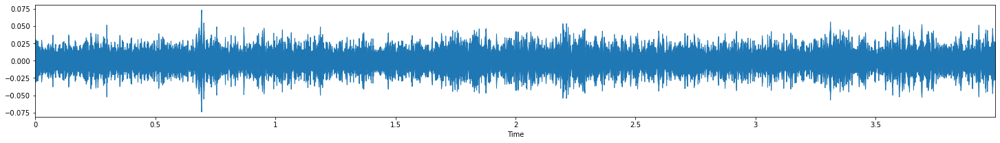

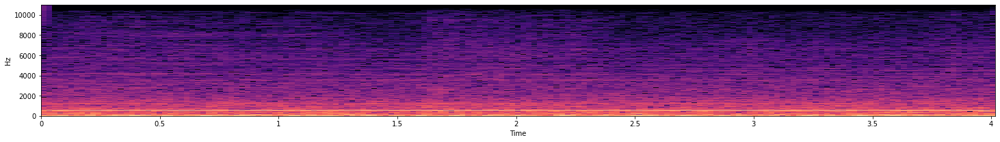

In [31]:
# examine air conditioner sample
audio_vis('/Users/spence/Documents/GitHub/Urban Sounds Classifier/UrbanSound8K/audio/fold5/85569-0-0-5.wav', 'air conditioner')

jack hammer


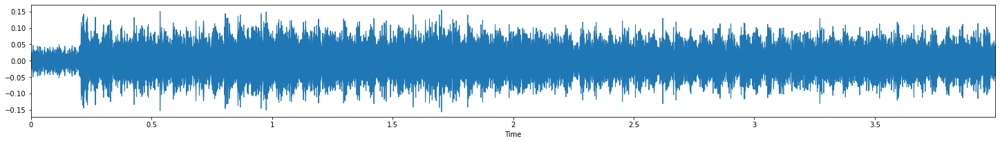

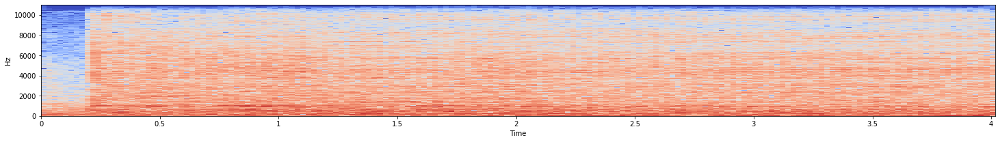

In [32]:
# examine jack hammer sample 
audio_vis('/Users/spence/Documents/GitHub/Urban Sounds Classifier/UrbanSound8K/audio/fold1/103074-7-0-0.wav', 'jack hammer')

street music


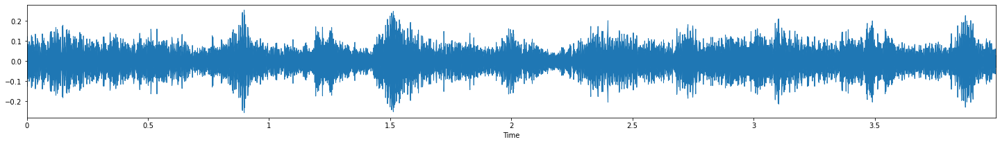

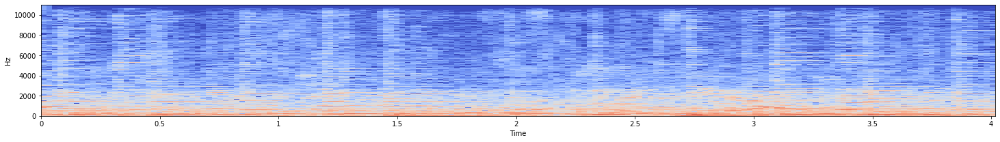

In [33]:
# examine street music sample
audio_vis('/Users/spence/Documents/GitHub/Urban Sounds Classifier/UrbanSound8K/audio/fold7/101848-9-0-0.wav', 'street music')

children playing


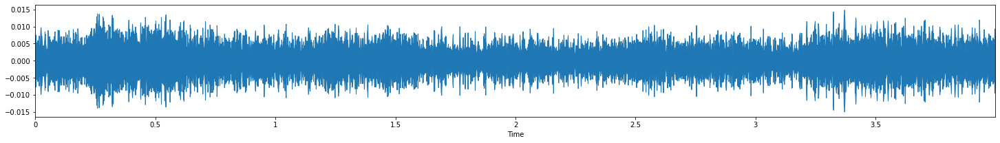

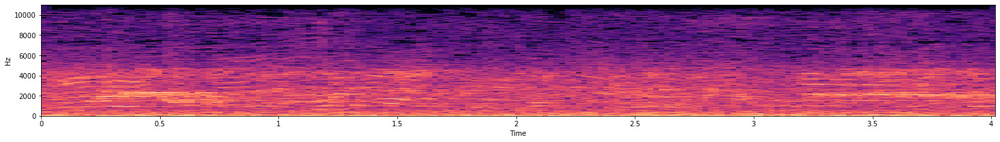

In [34]:
# examine children playing sample
audio_vis('/Users/spence/Documents/GitHub/Urban Sounds Classifier/UrbanSound8K/audio/fold5/100263-2-0-137.wav', 'children playing')

siren


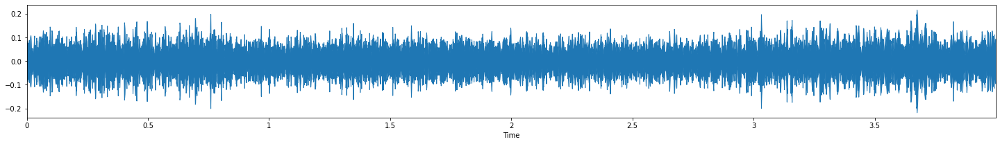

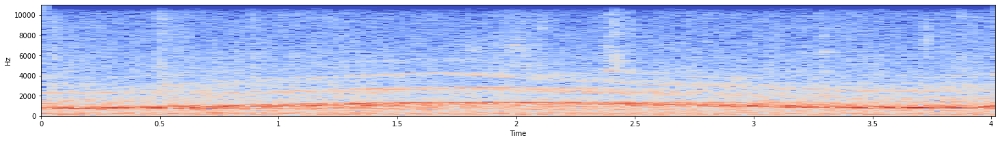

In [35]:
# examine siren sample 
audio_vis('/Users/spence/Documents/GitHub/Urban Sounds Classifier/UrbanSound8K/audio/fold7/102853-8-0-0.wav', 'siren')

gunshot


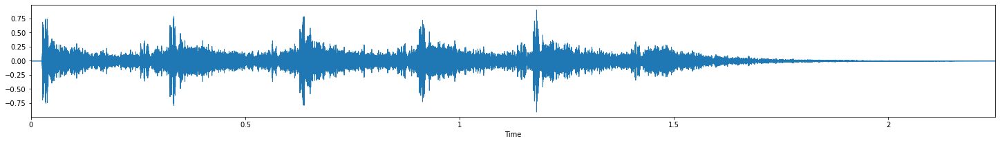

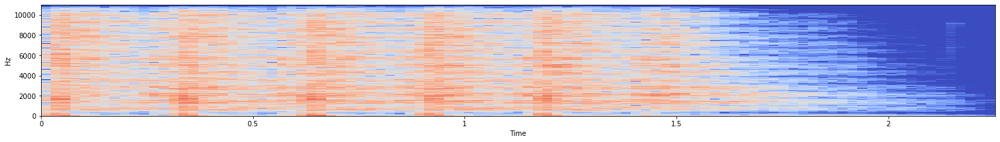

In [36]:
# examine gunshot sample 
audio_vis('/Users/spence/Documents/GitHub/Urban Sounds Classifier/UrbanSound8K/audio/fold1/7061-6-0-0.wav', 'gunshot')

car horn


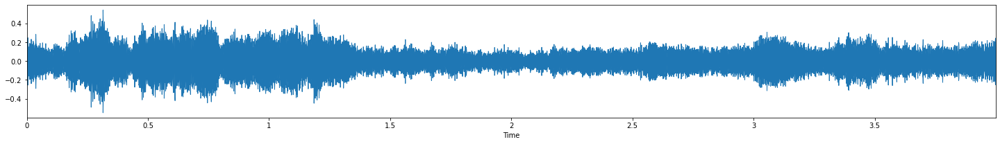

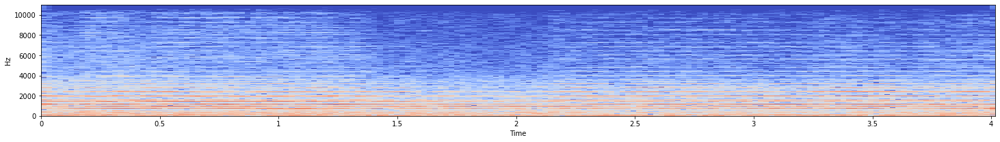

In [38]:
# examine car horn sample
audio_vis('/Users/spence/Documents/GitHub/Urban Sounds Classifier/UrbanSound8K/audio/fold1/24074-1-0-9.wav', 'car horn')

dog bark


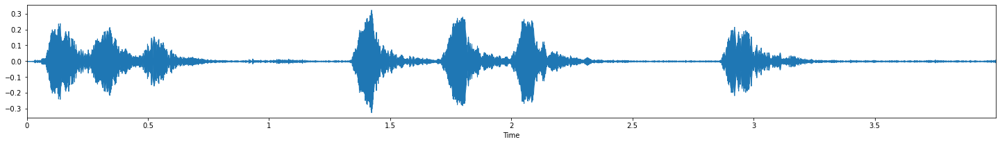

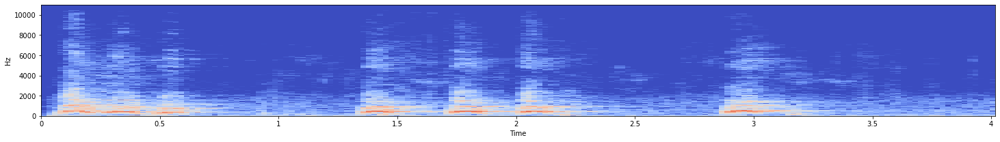

In [39]:
# examine dog bark sample 
audio_vis('/Users/spence/Documents/GitHub/Urban Sounds Classifier/UrbanSound8K/audio/fold1/7383-3-0-0.wav', 'dog bark')

drilling


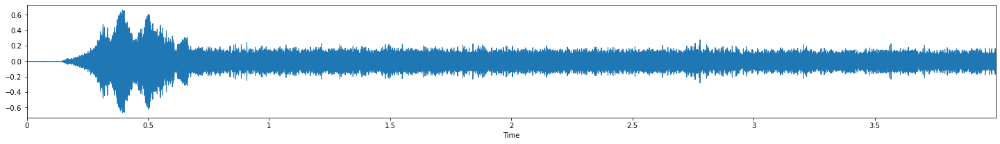

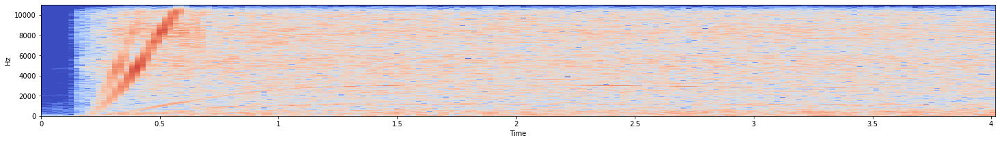

In [40]:
# examine drilling sample
audio_vis('/Users/spence/Documents/GitHub/Urban Sounds Classifier/UrbanSound8K/audio/fold1/46669-4-0-0.wav', 'drilling')

engine idling


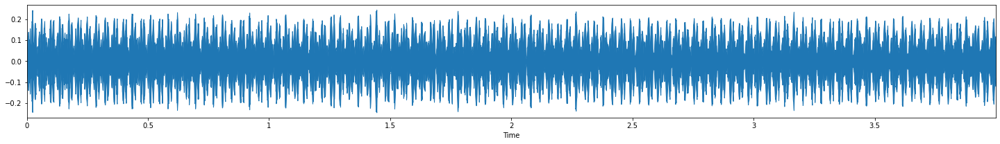

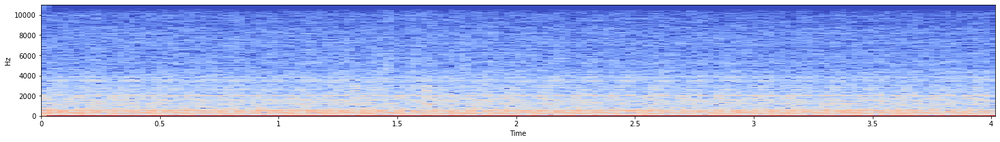

In [41]:
# examine engine idling sample 
audio_vis('/Users/spence/Documents/GitHub/Urban Sounds Classifier/UrbanSound8K/audio/fold1/17592-5-1-1.wav', 'engine idling')

# Aural & Visual Takeaways:

A lot of the visualizations appear to be monotenous. That is because alot of the sound classes are 'drone' type sounds; 'air conditioner', 'jackhammer', 'drilling', 'engine idling' are all monotone, droning sounds so there isn't much pitch/amplitdue variation to see. I believe it's possible that our model could have a hard time distinguishing between these sounds. 'Children playing' is also a bit of a drone, even though it's a higher pitch drone, it's very ambiant and lacking in distinct pitch variation. 

'Dog bark' and 'gun shot' are similar in that they have distinct transients. A transient is a part of a sound that has a rapid attack and fast decay, like the strike of a drum. Gun shots and dog barks are sudden loud spikes in sound amidst a background of environmental noise. You can see the light colored streaks on the spectrogram where the sound occurs. They are relatively easy to identify. The 'car horn' is also pretty distinct due to it's transient, however there is alot of loud background traffic noise making it harder to distinguish the specific horn sound.

The 'siren' sound here is a slow undulating sound with a long attack and long decay (the opposite of a transient). You can see the waveform in the spectrogram move up and then down. This sound is also relatuvely easy to distinguish, it move steadily up and adown in pitch on top of low droning backghround noise. 

The 'street music' sound is clearly identifiable as music. It's the only sound here that incorporates music, which is the intentional arranging of melody and rhythm. The model should have a relatively easy time classifying this class as long as the background noise isn't too prominent. 



# Feature Wrangling

Let's grab some basic audio characteristics from our samples.

**Sample Rate**: Sound is by nature analog or continuously variable, meaning it's infinitely divisible. When sound is digitized, snapshots (or samples) are taken of the analog waveform in order to capture and reproduce that sound. The amount of samples taken per second is called 'sample rate'. The most common sample rate is 44.1(44,100 samples per second) which is the sample rate of music on a CD. As one can imagine, the higher the sample rate the more 'accurate' the audio playback is, although this accuracy can be hard for the human ear to perceieve. 

**Bit Depth**: Bit depth refers to the number of bits of information in each sample. It directly corresponds to the resolution of each audio sample. The bit depth is responsible to the signal to noise ratio of the sound. Lower bit depths will be noiser and higher bit depths less so. 8 bit sounds are notoriously noisey. 16 bit is the standard for CD's. 

**Channels**: This simply refers to whether or not the sound is in stereo(2 channels) or mono(1 channel). Stereo means there is a left signal and right signal, it is similar to the way humans perceive sound (left ear, right ear). Mono means there is only one signal. Sometimes a mono signal can be duplicated and each signal gets panned left/right creating 'false stereo' which means there's a left and right channel that contain the *exact* same information. 



In [14]:
# view the sample rate, bit depth, and channel count for a random sound 

sound = wave.open('/Users/spence/Documents/GitHub/Urban Sounds Classifier/UrbanSound8K/audio/fold1/17592-5-1-1.wav', 'r')
print ( "Sample rate:",sound.getframerate())
print( "Number of channels:",sound.getnchannels())
print ( "Bit depth:",sound.getsampwidth() * 8)

Sample rate: 44100
Number of channels: 2
Bit depth: 16


In [15]:
# object and function that allows us to extract characteristics from each audio clip, source: https://gist.github.com/mikesmales/aa9426d33f904a4dbb64b5d46ef833c3

import struct
class WavFileHelper():
    
    def read_file_properties(self, filename):

        wave_file = open(filename,"rb")
        
        riff = wave_file.read(12)
        fmt = wave_file.read(36)
        
        num_channels_string = fmt[10:12]
        num_channels = struct.unpack('<H', num_channels_string)[0]

        sample_rate_string = fmt[12:16]
        sample_rate = struct.unpack("<I",sample_rate_string)[0]
        
        bit_depth_string = fmt[22:24]
        bit_depth = struct.unpack("<H",bit_depth_string)[0]

        return (num_channels, sample_rate, bit_depth)


audiodata = []
for index, row in sound_info.iterrows():
    
    file = os.path.join(os.path.abspath('/Users/spence/Documents/GitHub/Urban Sounds Classifier/UrbanSound8K/audio/'),'fold'+str(row["fold"])+'/',str(row["slice_file_name"]))
    data = WavFileHelper.read_file_properties(file, file)
    audiodata.append(data)

# Convert into a Panda dataframe
audiodf = pd.DataFrame(audiodata, columns=['num_channels','sample_rate','bit_depth'])

In [16]:
# join newly derived audio characteristics with metadata dataframe 

audio_df = sound_info.join(audiodf)
audio_df

,slice_file_name,fsID,start,end,salience,fold,classID,class,num_channels,sample_rate,bit_depth
0,100032-3-0-0.wav,100032,0.000000,0.317551,1,5,3,dog_bark,2,44100,16
1,100263-2-0-117.wav,100263,58.500000,62.500000,1,5,2,children_playing,2,44100,16
2,100263-2-0-121.wav,100263,60.500000,64.500000,1,5,2,children_playing,2,44100,16
3,100263-2-0-126.wav,100263,63.000000,67.000000,1,5,2,children_playing,2,44100,16
4,100263-2-0-137.wav,100263,68.500000,72.500000,1,5,2,children_playing,2,44100,16
...,...,...,...,...,...,...,...,...,...,...,...
8727,99812-1-2-0.wav,99812,159.522205,163.522205,2,7,1,car_horn,2,44100,16
8728,99812-1-3-0.wav,99812,181.142431,183.284976,2,7,1,car_horn,2,44100,16
8729,99812-1-4-0.wav,99812,242.691902,246.197885,2,7,1,car_horn,2,44100,16
8730,99812-1-5-0.wav,99812,253.209850,255.741948,2,7,1,car_horn,2,44100,16


In [17]:
# view sample rate counts 
audio_df.sample_rate.value_counts()

44100     5370
48000     2502
96000      610
24000       82
16000       45
22050       44
11025       39
192000      17
8000        12
11024        7
32000        4
Name: sample_rate, dtype: int64

In [18]:
# view bit depth counts 
audio_df.bit_depth.value_counts()

16    5758
24    2753
32     169
8       43
4        9
Name: bit_depth, dtype: int64

4 bits is very low quality, I'm interested in hearing these sounds to see if they are workable. 

In [19]:
# locate files that have a low bit depth
audio_df[audio_df['bit_depth'] == 4]

,slice_file_name,fsID,start,end,salience,fold,classID,class,num_channels,sample_rate,bit_depth
4803,19007-4-0-0.wav,19007,0.0,4.000000,2,5,4,drilling,1,22050,4
6246,36429-2-0-13.wav,36429,6.5,10.500000,2,8,2,children_playing,1,11024,4
6247,36429-2-0-14.wav,36429,7.0,11.000000,2,8,2,children_playing,1,11024,4
6248,36429-2-0-15.wav,36429,7.5,11.500000,2,8,2,children_playing,1,11024,4
6249,36429-2-0-18.wav,36429,9.0,13.000000,2,8,2,children_playing,1,11024,4
6250,36429-2-0-23.wav,36429,11.5,15.500000,2,8,2,children_playing,1,11024,4
6251,36429-2-0-6.wav,36429,3.0,7.000000,2,8,2,children_playing,1,11024,4
6252,36429-2-0-7.wav,36429,3.5,7.500000,2,8,2,children_playing,1,11024,4
8338,88466-7-0-0.wav,88466,0.0,1.662041,1,1,7,jackhammer,1,44100,4


In [26]:
# preview sample with low bit depth 
x, sr = lr.load('/Users/spence/Documents/GitHub/Urban Sounds Classifier/UrbanSound8K/audio/fold8/36429-2-0-13.wav')
print('children playing')
audio_play(x, sr) 

children playing


Wow! As expected the above sample is very poor quality. It's classified as 'children playing' however it sounds more like a droning engine or machinery. It's not misclassified beacuase I can hear the faint sound of children playing, however because the resolution (as measured by bit depth) is so low, the signal to noise ratio is terrible and our target sound is drowned out. 

In [27]:
# preview another sample with low bit depth 
x, sr = lr.load('/Users/spence/Documents/GitHub/Urban Sounds Classifier/UrbanSound8K/audio/fold5/19007-4-0-0.wav')
print('drilling')
audio_play(x, sr) 


drilling


The above sound is even worse! It's classified as drilling, however it sounds like indistinguishable clutter and there's even some humam chatter going on. 

In [42]:
# preview another sample with low bit depth 
x, sr = lr.load('/Users/spence/Documents/GitHub/Urban Sounds Classifier/UrbanSound8K/audio/fold1/88466-7-0-0.wav')
print('jack hammer')
audio_play(x, sr) 

jack hammer


The above jack hammer sound doesn't seem problematic. It has the distinct rhythm and tone of a jackhammer.

We can see if our Neural Network can handle these sounds. However, we may want to consider dropping them or applying some sort of noise reduction technique. Fortunately 'children playing' and 'drillng' are classes that are well represented in terms of the balance of our dataset, so dropping them shouldn't be a problem. 

In [22]:
# view mono/stereo counts 
audio_df.num_channels.value_counts()

2    7993
1     739
Name: num_channels, dtype: int64

Most of the sounds are in stereo, which is great!

In [24]:
# save dataframe
audio_df.to_csv('/Users/spence/Documents/GitHub/Urban Sounds Classifier/UrbanSound8K/metadata/audio_features.csv' , index=False)

This wraps up our EDA - Wrangling notebook. Next up will be extracting more advanced features from the audio!